# Actividad 4 - Percolación de una Red Cuadrada
#### Arif Morán Velázquez/A01234442
Diseña una estructura de datos en la que puedas codificar un grafo arbitrario.

In [258]:
using Plots
using LinearAlgebra
using Random
using Statistics
using LaTeXStrings

In [271]:
xf=100
N=20
xs=repeat(range(0,xf,N)',N);
ys=repeat(range(0,xf,N)',N)';
dx=diff(xs,dims=2)[1];

### Encontrar vecinos
Haz una función para inicializar un grafo en donde los nodos son puntos en una red cuadrada, y todos los nodos están conectados con sus primeros vecinos. Los enlaces son bidireccionales. .

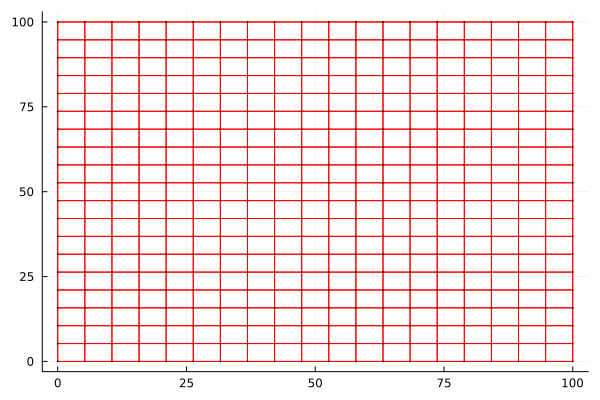

In [272]:
MA=zeros(N^2,4);
for i in 1:N^2
    k=0
    for j in 1:N^2
        if floor(sqrt((xs[i]-xs[j])^2+(ys[i]-ys[j])^2))==floor(dx) 
            k+=1
            MA[i,k]=j
        end
    end 
end

MA=sort(Int.(MA),dims=2);
plotg(xs,ys,MA)###Plot grid

In [ ]:
####Ezquinas
    MA[1,3]=N^2-(N-1)
    MA[1,4]=N


    MA[N,3]=N^2
    MA[N,4]=1

    MA[N^2,3]=N
    MA[N^2,4]=(N^2-(N-1))

    MA[N^2-(N-1),3]=1
    MA[N^2-(N-1),4]=(N^2)

############Extremos centrales

pp1=collect(N*2:N:N^2-N)
pp2=collect(N+1:N:N^2-N)
pp3=collect(2:N-1)
pp4=collect(N^2-(N-2):N^2-1)

MA[pp1,end]=pp2
MA[pp2,end]=pp1

MA[pp3,end]=pp4
MA[pp4,end]=pp3
MA=Int.(MA);

## Decimation

#### A partir de esta red completa, puedes obtener una subred si cortas una fracción $f$ de enlaces de forma aleatoria. A este proceso le llamamos decimación.

$$f=\frac{1}{10}$$

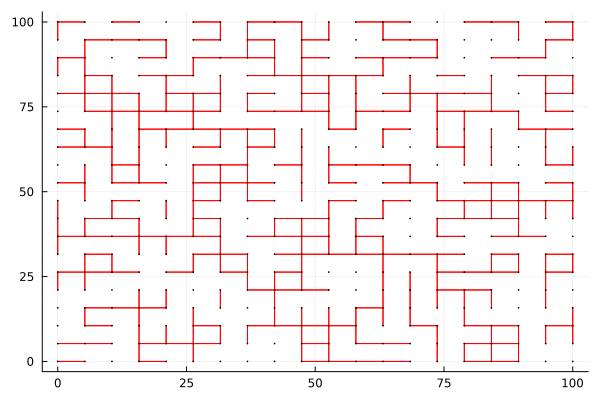

22-element Vector{Int64}:
   2
   3
   8
 229
   4
   3
  20
   2
   2
   4
   2
   6
  32
   3
   7
   2
   4
   3
   7
   7
   5
   6

In [273]:
f=20/40
MA1, NAR,scl=decimation(MA,N,f); ####MA es la matriz con la atualizacion de los vecinos NAR es el numero de enlaces resultantes 
plotg(xs,ys,MA1)
find_cluster_sizes(MA1)
#plot!(xs[cls2],ys[cls2],color="black",lw=4,label="")

$$f=3/5$$

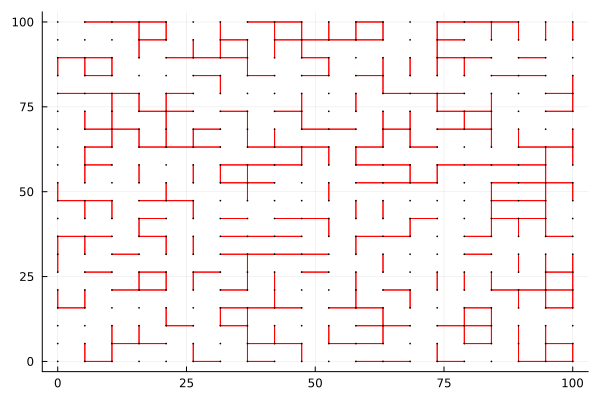

55-element Vector{Int64}:
  4
  6
  6
 26
  6
  8
  2
  7
  5
  2
  5
  5
  2
  ⋮
  2
 13
  2
  2
 12
  3
  8
  2
  2
  5
  2
  2

In [274]:
f=3/5
MA1, NAR,scl=decimation(MA,N,f);

plotg(xs,ys,MA1)
find_cluster_sizes(MA1)
#plot!(xs[cls2],ys[cls2],color="black",lw=4,label="")
#histogram(scl)

Utiliza este algoritmo para encontrar la distribución de tamaños de cluster para una fracción de decimación $f$. Grafica los histogramas de los tamaños de cluster para varios valores de 
 en un sólo par de ejes. 

In [275]:
nf=1000 ## Numero de Fs
NN=1000 ### numero de experimentos

f=range(0,0.99,nf)
data1=zeros(NN,nf)
med1=zeros(NN,nf)
max1=zeros(NN,nf)
sd1=zeros(NN,nf)

for j in 1:NN
    data=[]
    med=[]
    sd=[]
    max=[]
    for i in f
        MA1, NAR,scl=decimation(MA,N,i);
        data=vcat(data,find_cluster_sizes(MA1))
        med=vcat(med,mean(find_cluster_sizes(MA1)))
        max=vcat(max,maximum(find_cluster_sizes(MA1)))
        sd=vcat(sd,std(find_cluster_sizes(MA1)))
    end
    #data1[j,:]=data
    med1[j,:]=med'
    max1[j,:]=max'
    sd1[j,:]=sd'
end

fs=repeat(f',NN);


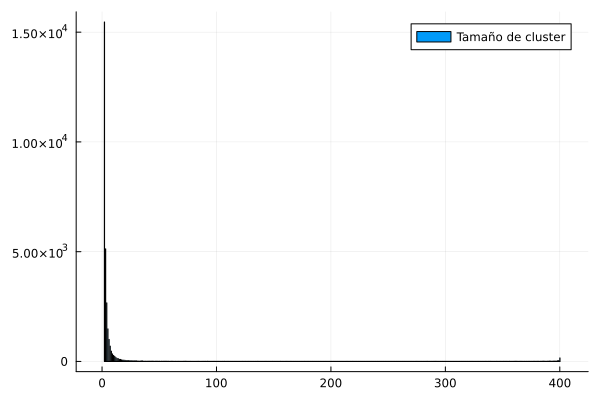

In [276]:
histogram(data,label="Tamaño de cluster")

Grafica, como función de la fracción $f$
, el tamaño medio de los clusters y la desviación estándard. También grafica el tamaño promedio del cluster más grande. 

In [277]:
α=0.004
plot(fs,max1,color="red",label="",alpha=α)
plot!(f,mean(max1,dims=1)',label="Promedio maximos"*L"\langle max \rangle",color="red")

In [278]:
plot(fs,med1,color="blue",label="",alpha=α)
plot!(f,mean(med1,dims=1)',label="Promedio de los experimentos",color="blue")

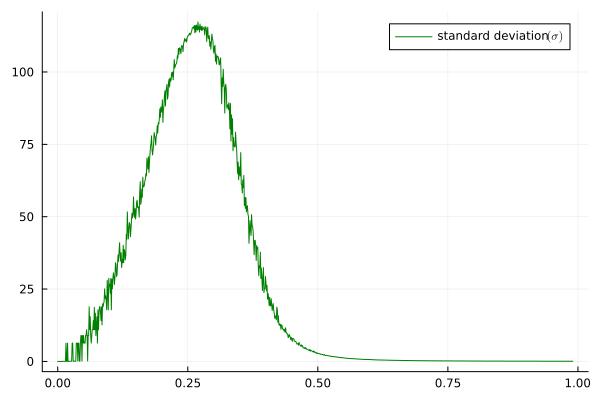

In [279]:
#plot(fs,sd1,color="green",label="",alpha=α)
#plot(fs,sd1,color="red",label="",alpha=α)
#plot!(f,mean(sd1,dims=1)',label="standard deviation Dr.borja",color="red")
plot(f,(std(med1,dims=1))',label="standard deviation"*L"(\sigma)",color="green")

## Decimation de numeros especificos

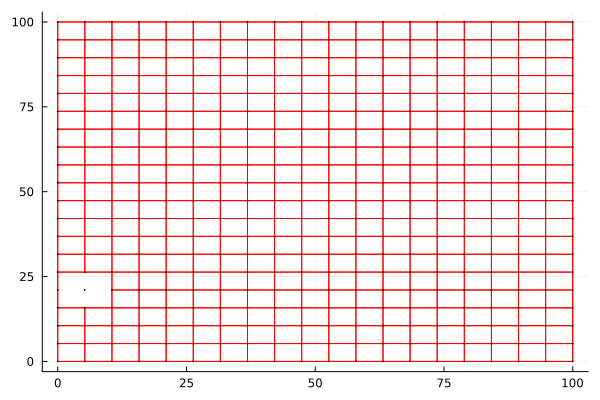

In [281]:
MA1=decimation2(MA,N,25)
plotg(xs,ys,MA1)

In [4]:
function plotg(xs,ys,MA1)
    p=plot()
    for i in 1:N^2
        for j in 1:4
            if MA1[i,j]>0
                plot!([xs[i],xs[MA1[i,j]]],[ys[i],ys[MA1[i,j]]],color="red",label="")
                #plot!()
            end
        end
    end
    scatter!(xs,ys,label="",markersize=1,color="black")
    display(p)
end

plotg (generic function with 1 method)

In [5]:
function decimation(MA,N,f)

    NE=N*(N-1)*2 #### Numero de Enlaces
    F=Int(round(f*NE)) ####Numero de enlaces a remover
    
    pp= rand(1:(N^2)*4,F)
    #II=rand(1:4,F)
    
    choclo=copy(MA);
    
    for i in 1:F #### quita los elementos de la fila dada,y busca su contra parte y la remueve
        H=choclo[pp[i]]
        while H==0### si el elemento aleatorio refleja un 0 dentro de la matriz con las conecciones , se pide otro numero
            pp[i]=rand(1:(N^2)*4)
            H=choclo[pp[i]]
        end
        row, col = lirc(choclo,pp[i]) ####indice lineal a matricial, fila y columna
        choclo[H,:]=replace(choclo[H,:], row => 0)
        choclo[pp[i]]=0      
    end
    #############Calculo valores para el histograma
    clusters=choclo./choclo
    clusters=replace(clusters, NaN => 0);
    scl=sum(clusters,dims=2)
    #histogram(scl)
    return sort(choclo,dims=2),(NE-F),scl
end

decimation (generic function with 1 method)

In [70]:
function find_cluster_sizes(matrix)
    num_points = size(matrix, 1)
    visited = falses(num_points)
    cluster_sizes = Int[]

    function dfs(point)
        visited[point] = true
        cluster_size = 1

        for neighbor in matrix[point, :]
            if neighbor != 0 && !visited[neighbor]
                cluster_size += dfs(neighbor)
            end
        end

        return cluster_size
    end

    for point in 1:num_points
        if !visited[point]
            cluster_size = dfs(point)
            push!(cluster_sizes, cluster_size)
        end
    end
    cluster_sizes=filter(x -> x != 1,cluster_sizes)
    return cluster_sizes
end

# Example matrix


# Find cluster sizes
cluster_sizes = find_cluster_sizes(MA1)

# Print the cluster sizes
println("Cluster Sizes: ", cluster_sizes)


Cluster Sizes: [4, 18]


In [7]:
function lirc(matrix, linear_index) ###########Funcion que transforma un indice lineal a matricial, fila y columna
    num_rows, num_cols = size(matrix)
    col = div(linear_index - 1, num_rows) + 1
    row = linear_index % num_rows
    row == 0 && (row = num_rows)
    return row, col
end

lirc (generic function with 1 method)